# Run Millipede on Latest ABE8e Pooled Data

### Install latest version of crispr-millipede

In [105]:
reinstall = True

if reinstall:    
    version = "0.1.89"
    !pip install --upgrade --no-cache-dir crispr-millipede==$version

  Attempting uninstall: crispr-millipede
    Found existing installation: crispr-millipede 0.1.88
    Uninstalling crispr-millipede-0.1.88:
      Successfully uninstalled crispr-millipede-0.1.88


In [ ]:
!pip install ipywidgets

### Import packages

In [155]:
%load_ext autoreload
%autoreload 2

from crispr_millipede import encoding as cme
from crispr_millipede import modelling as cmm


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [156]:
import pandas as pd
import numpy as np

from Bio import SeqIO
from Bio.Seq import Seq

### Perform encoding

In [157]:
amplicon = "ACATGCTCTAGTGAAAGCCAGTCTGGGCAGCTGGGTAGCTAATGAGGGGATTAGAGAGATTTTGTTGAATGAAAGGCAGATTGAGTCCTGCTACTCGCCCCCTTCATTCCCCTTCATTCATGCCTCATTCTTCCGCCTCCCAGCCGCCTCAACTGGCCAAAGGGAAGTGGAGGCCCTGCCACCTGTAGGGAGGGTCCCCTGGGGCTTGCCCACAGCAAACAGGAAGTCACAGCCTGGTGAGATGGGCCTGGGAATCAGCCACTGAGAAAGTGGGTCTCTTGGGTCCCTGAATTCTTTTTCTGAGTCCCTGCAGCAGTGAAAAAGACACAGAGGCACATAGAGAGTG"
print(f"Length of amplicon {len(amplicon)}")

Length of amplicon 346


**Prepare encoding parameters**

**Prepare guide edit positions for denoising**

We can set an option to denoise only edits within the expected editing window

In [158]:
core_data_dir = "/data/pinello/PROJECTS/2023_08_CD19_manuscript/Core_Data/"

#  Guide DF Filenames
CD19_guide_library_fn = f"{core_data_dir}CD19_sgRNA_count_libraries_DS.txt"

# Load CD19 Library
CD19_guide_library_raw_df = pd.read_table(CD19_guide_library_fn, encoding='utf-8')
CD19_guide_library_raw_df.columns = [colname.strip() for colname in CD19_guide_library_raw_df.columns]

In [159]:
# Prepare dataframe for CRISPR-SURF input
CD19_guide_library_SURFinput_df = pd.DataFrame({"Chr": CD19_guide_library_raw_df["chromosome_#"],
            "Start": CD19_guide_library_raw_df["start"],
            "Stop": CD19_guide_library_raw_df["end"],
            "sgRNA_Sequence": CD19_guide_library_raw_df["sgRNA"],
            "Strand": CD19_guide_library_raw_df["strand"],
            "sgRNA_Type_ABE": np.where(CD19_guide_library_raw_df["start"].isna(), "negative_control", "observation"),
            "sgRNA_Type_CBE": np.where(CD19_guide_library_raw_df["start"].isna(), "negative_control", "observation")})

CD19_guide_library_SURFinput_df["Chr"] = CD19_guide_library_SURFinput_df["Chr"].str.replace(",","_")
CD19_guide_library_SURFinput_df.to_csv("./CD19_guide_library_SURFinput.csv", index=False)

In [160]:
# Set predicted cutsite for each guide

CD19_guide_library_SURFinput_df_cutsite = CD19_guide_library_SURFinput_df.copy()
CD19_guide_library_SURFinput_df_cutsite["Cutsite"] = np.where(CD19_guide_library_SURFinput_df_cutsite["Strand"] == "+", CD19_guide_library_SURFinput_df_cutsite["Start"]+6, CD19_guide_library_SURFinput_df_cutsite["Start"]+14)

In [161]:
complete_amplicon_sequence = Seq(amplicon)

def get_start_coordinate(row):
    start_coordinate = complete_amplicon_sequence.find(row["sgRNA_Sequence"])
    end_coordinate = start_coordinate + 20
    editsite_coordinate = start_coordinate + 6
    if start_coordinate == -1:
        end_coordinate = complete_amplicon_sequence.find(Seq(row["sgRNA_Sequence"]).reverse_complement())
        if end_coordinate == -1:
            pass
        else:
            start_coordinate = end_coordinate + 20
            editsite_coordinate = start_coordinate - 6
            PAM = str(complete_amplicon_sequence[end_coordinate-3:end_coordinate].reverse_complement())
            assert row["Strand"].strip() == "-"
    else:
        PAM = str(complete_amplicon_sequence[end_coordinate:end_coordinate+3])
        assert row["Strand"].strip() == "+"
    
    if (start_coordinate != -1) and (end_coordinate != -1):
        return pd.Series([start_coordinate, end_coordinate, editsite_coordinate, PAM], index=["start_coordinate_amplicon", "end_coordinate_amplicon", "editsite_coordinate_amplicon", "PAM"])
    else: 
        return pd.Series([None, None, None, None], index=["start_coordinate_amplicon", "end_coordinate_amplicon", "editsite_coordinate_amplicon", "PAM"])
amplicon_coordinates_df = CD19_guide_library_SURFinput_df_cutsite.apply(get_start_coordinate, axis=1)

CD19_guide_library_SURFinput_df_cutsite_with_amplicon_coordinates = pd.concat([CD19_guide_library_SURFinput_df_cutsite, amplicon_coordinates_df], axis=1)
CD19_guide_library_SURFinput_df_cutsite_with_amplicon_coordinates = CD19_guide_library_SURFinput_df_cutsite_with_amplicon_coordinates[~CD19_guide_library_SURFinput_df_cutsite_with_amplicon_coordinates["start_coordinate_amplicon"].isna()]

ABE8e_final_editsites = list(np.sort(CD19_guide_library_SURFinput_df_cutsite_with_amplicon_coordinates["editsite_coordinate_amplicon"].astype(int).unique()))
EvoCDA_final_editsites = list(np.sort(CD19_guide_library_SURFinput_df_cutsite_with_amplicon_coordinates[CD19_guide_library_SURFinput_df_cutsite_with_amplicon_coordinates["PAM"].str[1:] == "GG"]["editsite_coordinate_amplicon"].astype(int).unique()))
print(ABE8e_final_editsites)
print(EvoCDA_final_editsites)

[7, 10, 13, 15, 16, 18, 19, 21, 22, 24, 25, 28, 30, 31, 34, 37, 39, 42, 43, 45, 46, 48, 49, 51, 52, 54, 55, 57, 60, 61, 64, 66, 67, 69, 70, 72, 73, 75, 76, 78, 79, 81, 82, 84, 85, 88, 90, 91, 93, 94, 96, 97, 100, 102, 103, 106, 108, 109, 111, 112, 114, 115, 117, 118, 120, 121, 123, 124, 126, 127, 129, 130, 132, 133, 135, 136, 138, 139, 141, 142, 144, 145, 147, 148, 150, 153, 154, 156, 157, 160, 162, 163, 165, 166, 168, 169, 171, 172, 174, 175, 177, 180, 181, 183, 184, 186, 187, 189, 190, 192, 193, 195, 196, 198, 199, 201, 202, 204, 205, 208, 210, 213, 214, 216, 217, 219, 222, 223, 225, 226, 228, 229, 231, 232, 234, 235, 237, 238, 240, 241, 243, 246, 247, 249, 250, 252, 253, 255, 259, 261, 262, 265, 267, 268, 270, 271, 273, 276, 277, 279, 280, 282, 283, 285, 286, 288, 289, 291, 292, 294, 295, 297, 298, 300, 303, 307, 309, 310, 312, 313, 315, 318, 319, 321, 322, 324, 325, 327, 328, 330, 331, 333]
[10, 31, 114, 117, 126, 139, 156, 172, 187, 195, 198, 213, 225, 229, 235, 249, 265]


### Prepare encoding parameters

In [8]:
root_dir = "/data/pinello/PROJECTS/2023_08_CD19_manuscript/Core_Processing_Analysis/Analysis/ABE8e_Pooled_Endogenous_Redo_SecondAttempt_No_Contaminant_CRISPResso2_Analysis/20240606_CRISPResso2Batch_Results/ABE8e_pooled/unmerged_PE_middle/CRISPRessoBatch_on_ABE8e_pooled_unmerged_PE_middle/"

encoding_parameters_denoised_removed = cme.EncodingParameters(complete_amplicon_sequence="ACATGCTCTAGTGAAAGCCAGTCTGGGCAGCTGGGTAGCTAATGAGGGGATTAGAGAGATTTTGTTGAATGAAAGGCAGATTGAGTCCTGCTACTCGCCCCCTTCATTCCCCTTCATTCATGCCTCATTCTTCCGCCTCCCAGCCGCCTCAACTGGCCAAAGGGAAGTGGAGGCCCTGCCACCTGTAGGGAGGGTCCCCTGGGGCTTGCCCACAGCAAACAGGAAGTCACAGCCTGGTGAGATGGGCCTGGGAATCAGCCACTGAGAAAGTGGGTCTCTTGGGTCCCTGAATTCTTTTTCTGAGTCCCTGCAGCAGTGAAAAAGACACAGAGGCACATAGAGAGTG",
                            population_baseline_suffix="_CD19minus",
                            population_target_suffix="_CD19plus",
                            population_presort_suffix="_presort",
                            wt_suffix="_wt",
                            trim_left=20,
                            trim_right=20,
                            guide_edit_positions=ABE8e_final_editsites, 
                            guide_window_halfsize = 3, 
                            variant_types=[("A", "G"), ("T", "C")],
                            remove_denoised=True)

encoding_parameters_denoised_nonremoved = cme.EncodingParameters(complete_amplicon_sequence="ACATGCTCTAGTGAAAGCCAGTCTGGGCAGCTGGGTAGCTAATGAGGGGATTAGAGAGATTTTGTTGAATGAAAGGCAGATTGAGTCCTGCTACTCGCCCCCTTCATTCCCCTTCATTCATGCCTCATTCTTCCGCCTCCCAGCCGCCTCAACTGGCCAAAGGGAAGTGGAGGCCCTGCCACCTGTAGGGAGGGTCCCCTGGGGCTTGCCCACAGCAAACAGGAAGTCACAGCCTGGTGAGATGGGCCTGGGAATCAGCCACTGAGAAAGTGGGTCTCTTGGGTCCCTGAATTCTTTTTCTGAGTCCCTGCAGCAGTGAAAAAGACACAGAGGCACATAGAGAGTG",
                            population_baseline_suffix="_CD19minus",
                            population_target_suffix="_CD19plus",
                            population_presort_suffix="_presort",
                            wt_suffix="_wt",
                            trim_left=20,
                            trim_right=20,
                            guide_edit_positions=ABE8e_final_editsites, 
                            guide_window_halfsize = 3, 
                            variant_types=[("A", "G"), ("T", "C")],
                            remove_denoised=False)



encoding_parameters_denoised_nonvariant_removed = cme.EncodingParameters(complete_amplicon_sequence="ACATGCTCTAGTGAAAGCCAGTCTGGGCAGCTGGGTAGCTAATGAGGGGATTAGAGAGATTTTGTTGAATGAAAGGCAGATTGAGTCCTGCTACTCGCCCCCTTCATTCCCCTTCATTCATGCCTCATTCTTCCGCCTCCCAGCCGCCTCAACTGGCCAAAGGGAAGTGGAGGCCCTGCCACCTGTAGGGAGGGTCCCCTGGGGCTTGCCCACAGCAAACAGGAAGTCACAGCCTGGTGAGATGGGCCTGGGAATCAGCCACTGAGAAAGTGGGTCTCTTGGGTCCCTGAATTCTTTTTCTGAGTCCCTGCAGCAGTGAAAAAGACACAGAGGCACATAGAGAGTG",
                            population_baseline_suffix="_CD19minus",
                            population_target_suffix="_CD19plus",
                            population_presort_suffix="_presort",
                            wt_suffix="_wt",
                            trim_left=20,
                            trim_right=20,
                            guide_edit_positions=ABE8e_final_editsites, 
                            guide_window_halfsize = 3,
                            remove_denoised=True)

encoding_parameters_denoised_nonvariant_nonremoved = cme.EncodingParameters(complete_amplicon_sequence="ACATGCTCTAGTGAAAGCCAGTCTGGGCAGCTGGGTAGCTAATGAGGGGATTAGAGAGATTTTGTTGAATGAAAGGCAGATTGAGTCCTGCTACTCGCCCCCTTCATTCCCCTTCATTCATGCCTCATTCTTCCGCCTCCCAGCCGCCTCAACTGGCCAAAGGGAAGTGGAGGCCCTGCCACCTGTAGGGAGGGTCCCCTGGGGCTTGCCCACAGCAAACAGGAAGTCACAGCCTGGTGAGATGGGCCTGGGAATCAGCCACTGAGAAAGTGGGTCTCTTGGGTCCCTGAATTCTTTTTCTGAGTCCCTGCAGCAGTGAAAAAGACACAGAGGCACATAGAGAGTG",
                            population_baseline_suffix="_CD19minus",
                            population_target_suffix="_CD19plus",
                            population_presort_suffix="_presort",
                            wt_suffix="_wt",
                            trim_left=20,
                            trim_right=20,
                            guide_edit_positions=ABE8e_final_editsites, 
                            guide_window_halfsize = 3,
                            remove_denoised=False)
                                           
                                           
    
encoding_parameters_nondenoised = cme.EncodingParameters(complete_amplicon_sequence="ACATGCTCTAGTGAAAGCCAGTCTGGGCAGCTGGGTAGCTAATGAGGGGATTAGAGAGATTTTGTTGAATGAAAGGCAGATTGAGTCCTGCTACTCGCCCCCTTCATTCCCCTTCATTCATGCCTCATTCTTCCGCCTCCCAGCCGCCTCAACTGGCCAAAGGGAAGTGGAGGCCCTGCCACCTGTAGGGAGGGTCCCCTGGGGCTTGCCCACAGCAAACAGGAAGTCACAGCCTGGTGAGATGGGCCTGGGAATCAGCCACTGAGAAAGTGGGTCTCTTGGGTCCCTGAATTCTTTTTCTGAGTCCCTGCAGCAGTGAAAAAGACACAGAGGCACATAGAGAGTG",
                            population_baseline_suffix="_CD19minus",
                            population_target_suffix="_CD19plus",
                            population_presort_suffix="_presort",
                            wt_suffix="_wt",
                            trim_left=20,
                            trim_right=20)


                                                         
                                                         
encoding_dataframes_denoised_removed = cme.EncodingDataFrames(encoding_parameters=encoding_parameters_denoised_removed,
                                                 reference_sequence=encoding_parameters_denoised_removed.complete_amplicon_sequence,
                                                 population_baseline_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_pooled_low_1/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_pooled_low_2/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_pooled_low_3/Alleles_frequency_table.zip"],
                                                 population_target_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_pooled_high_1/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_pooled_high_2/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_pooled_high_3/Alleles_frequency_table.zip"],
                                                 population_presort_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_pooled_presort_1/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_pooled_presort_2/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_pooled_presort_3/Alleles_frequency_table.zip"],
                                                 wt_filepaths=[root_dir + "CRISPResso_on_sample_mock_presort_1/Alleles_frequency_table.zip"])

encoding_dataframes_denoised_nonremoved = cme.EncodingDataFrames(encoding_parameters=encoding_parameters_denoised_nonremoved,
                                                 reference_sequence=encoding_parameters_denoised_nonremoved.complete_amplicon_sequence,
                                                 population_baseline_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_pooled_low_1/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_pooled_low_2/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_pooled_low_3/Alleles_frequency_table.zip"],
                                                 population_target_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_pooled_high_1/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_pooled_high_2/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_pooled_high_3/Alleles_frequency_table.zip"],
                                                 population_presort_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_pooled_presort_1/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_pooled_presort_2/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_pooled_presort_3/Alleles_frequency_table.zip"],
                                                 wt_filepaths=[root_dir + "CRISPResso_on_sample_mock_presort_1/Alleles_frequency_table.zip"])


encoding_dataframes_nondenoised = cme.EncodingDataFrames(encoding_parameters=encoding_parameters_nondenoised,
                                                 reference_sequence=encoding_parameters_nondenoised.complete_amplicon_sequence,
                                                 population_baseline_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_pooled_low_1/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_pooled_low_2/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_pooled_low_3/Alleles_frequency_table.zip"],
                                                 population_target_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_pooled_high_1/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_pooled_high_2/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_pooled_high_3/Alleles_frequency_table.zip"],
                                                 population_presort_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_pooled_presort_1/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_pooled_presort_2/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_pooled_presort_3/Alleles_frequency_table.zip"],
                                                 wt_filepaths=[root_dir + "CRISPResso_on_sample_mock_presort_1/Alleles_frequency_table.zip"])


encoding_dataframes_denoised_nonvariant_removed = cme.EncodingDataFrames(encoding_parameters=encoding_parameters_denoised_nonvariant_removed,
                                                 reference_sequence=encoding_parameters_denoised_nonvariant_removed.complete_amplicon_sequence,
                                                 population_baseline_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_pooled_low_1/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_pooled_low_2/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_pooled_low_3/Alleles_frequency_table.zip"],
                                                 population_target_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_pooled_high_1/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_pooled_high_2/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_pooled_high_3/Alleles_frequency_table.zip"],
                                                 population_presort_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_pooled_presort_1/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_pooled_presort_2/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_pooled_presort_3/Alleles_frequency_table.zip"],
                                                 wt_filepaths=[root_dir + "CRISPResso_on_sample_mock_presort_1/Alleles_frequency_table.zip"])

encoding_dataframes_denoised_nonvariant_nonremoved = cme.EncodingDataFrames(encoding_parameters=encoding_parameters_denoised_nonvariant_nonremoved,
                                                 reference_sequence=encoding_parameters_denoised_nonvariant_nonremoved.complete_amplicon_sequence,
                                                 population_baseline_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_pooled_low_1/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_pooled_low_2/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_pooled_low_3/Alleles_frequency_table.zip"],
                                                 population_target_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_pooled_high_1/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_pooled_high_2/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_pooled_high_3/Alleles_frequency_table.zip"],
                                                 population_presort_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_pooled_presort_1/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_pooled_presort_2/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_pooled_presort_3/Alleles_frequency_table.zip"],
                                                 wt_filepaths=[root_dir + "CRISPResso_on_sample_mock_presort_1/Alleles_frequency_table.zip"])

In [162]:
 encoding_parameters_denoised_nonposition_nontrimmed_removed = cme.EncodingParameters(complete_amplicon_sequence="ACATGCTCTAGTGAAAGCCAGTCTGGGCAGCTGGGTAGCTAATGAGGGGATTAGAGAGATTTTGTTGAATGAAAGGCAGATTGAGTCCTGCTACTCGCCCCCTTCATTCCCCTTCATTCATGCCTCATTCTTCCGCCTCCCAGCCGCCTCAACTGGCCAAAGGGAAGTGGAGGCCCTGCCACCTGTAGGGAGGGTCCCCTGGGGCTTGCCCACAGCAAACAGGAAGTCACAGCCTGGTGAGATGGGCCTGGGAATCAGCCACTGAGAAAGTGGGTCTCTTGGGTCCCTGAATTCTTTTTCTGAGTCCCTGCAGCAGTGAAAAAGACACAGAGGCACATAGAGAGTG",
                            population_baseline_suffix="_CD19minus",
                            population_target_suffix="_CD19plus",
                            population_presort_suffix="_presort",
                            wt_suffix="_wt",
                            variant_types=[("A", "G"), ("T", "C")],
                            remove_denoised=True)

In [163]:
encoding_dataframes_denoised_nonposition_nontrimmed_removed = cme.EncodingDataFrames(encoding_parameters=encoding_parameters_denoised_nonposition_nontrimmed_removed,
                                                 reference_sequence=encoding_parameters_denoised_nonposition_nontrimmed_removed.complete_amplicon_sequence,
                                                 population_baseline_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_pooled_low_1/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_pooled_low_2/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_pooled_low_3/Alleles_frequency_table.zip"],
                                                 population_target_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_pooled_high_1/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_pooled_high_2/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_pooled_high_3/Alleles_frequency_table.zip"],
                                                 population_presort_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_pooled_presort_1/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_pooled_presort_2/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_pooled_presort_3/Alleles_frequency_table.zip"],
                                                 wt_filepaths=[root_dir + "CRISPResso_on_sample_mock_presort_1/Alleles_frequency_table.zip"])

In [164]:
%%time
# Takes around 48min for 50cores
print("Reading tables")
encoding_dataframes_denoised_nonposition_nontrimmed_removed.read_crispresso_allele_tables()
print("Encoding tables")
encoding_dataframes_denoised_nonposition_nontrimmed_removed.encode_crispresso_allele_table(progress_bar=True, cores=60)
print("Postprocessing tables")
encoding_dataframes_denoised_nonposition_nontrimmed_removed.postprocess_encoding()

Reading tables
Encoding tables
INFO: Pandarallel will run on 60 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
Encoding population_baseline_df


Encoding population_target_df


Encoding population_presort_df


Encoding population_wt_df


Postprocessing tables
Processing encoding columns
Adding read column
Performing denoising
Denoising with positions [] and variant types [('A', 'G'), ('T', 'C')]
Filtering by variant types
1572 variant types
['0A>C', '0A>T', '0A>N', '0A>-', '1C>A', '1C>T', '1C>G', '1C>N', '1C>-', '2A>C', '2A>T', '2A>N', '2A>-', '3T>A', '3T>G', '3T>N', '3T>-', '4G>A', '4G>C', '4G>T', '4G>N', '4G>-', '5C>A', '5C>T', '5C>G', '5C>N', '5C>-', '6T>A', '6T>G', '6T>N', '6T>-', '7C>A', '7C>T', '7C>G', '7C>N', '7C>-', '8T>A', '8T>G', '8T>N', '8T>-', '9A>C', '9A>T', '9A>N', '9A>-', '10G>A', '10G>C', '10G>T', '10G>N', '10G>-', '11T>A', '11T>G', '11T>N', '11T>-', '12G>A', '12G>C', '12G>T', '12G>N', '12G>-', '13A>C', '13A>T', '13A>N', '13A>-', '14A>C', '14A>T', '14A>N', '14A>-', '15A>C', '15A>T', '15A>N', '15A>-', '16G>A', '16G>C', '16G>T', '16G>N', '16G>-', '17C>A', '17C>T', '17C>G', '17C>N', '17C>-', '18C>A', '18C>T', '18C>G', '18C>N', '18C>-', '19A>C', '19A>T', '19A>N', '19A>-', '20G>A', '20G>C', '20G>T', '20G>N',

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.groupby(feature_colnames, as_index=True).sum().reset_index())
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.

CPU times: user 3min 37s, sys: 26min 8s, total: 29min 45s
Wall time: 1h 2min 17s


In [166]:
import pickle

rerun = True
if rerun:
    with open('20240901_v0_1_89_encoding_dataframes_denoised_nonposition_nontrimmed_removed.pkl', 'wb') as fn: 
        pickle.dump(encoding_dataframes_denoised_nonposition_nontrimmed_removed, fn) 
else:
    with open('20240901_v0_1_89_encoding_dataframes_denoised_nonposition_nontrimmed_removed.pkl', 'rb') as fn: 
        encoding_dataframes_denoised_nonposition_nontrimmed_removed = pickle.load(fn) 

In [167]:
cme.save_encodings(encoding_dataframes_denoised_nonposition_nontrimmed_removed.encodings_collapsed_merged, sort_column="#Reads_presort", filename="./20240901_v0_1_89_encoding_dataframes_denoised_nonposition_nontrimmed_removed_ABE8e_encodings_rep{}.tsv")
cme.save_encodings(encoding_dataframes_denoised_nonposition_nontrimmed_removed.population_wt_encoding_processed, sort_column="#Reads_wt", filename="./20240901_v0_1_89_encoding_dataframes_denoised_nonposition_nontrimmed_removed_wt_encodings_rep{}.tsv")
cme.save_encodings_df(encoding_dataframes_denoised_nonposition_nontrimmed_removed.population_baseline_encoding_processed, filename="./20240901_v0_1_89_encoding_dataframes_denoised_nonposition_nontrimmed_removed_CD19minus_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_nonposition_nontrimmed_removed.population_target_encoding_processed, filename="./20240901_v0_1_89_encoding_dataframes_denoised_nonposition_nontrimmed_removed_CD19plus_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_nonposition_nontrimmed_removed.population_presort_encoding_processed, filename="./20240901_v0_1_89_encoding_dataframes_denoised_nonposition_nontrimmed_removed_presort_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_nonposition_nontrimmed_removed.population_wt_encoding_processed, filename="./20240901_v0_1_89_encoding_dataframes_denoised_nonposition_nontrimmed_removed_wt_encodings_rep{}.pkl")

In [9]:
%%time
# Takes around 48min for 50cores
print("Reading tables")
encoding_dataframes_denoised_removed.read_crispresso_allele_tables()
print("Encoding tables")
encoding_dataframes_denoised_removed.encode_crispresso_allele_table(progress_bar=True, cores=60)
print("Postprocessing tables")
encoding_dataframes_denoised_removed.postprocess_encoding()

Reading tables
Encoding tables
INFO: Pandarallel will run on 60 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
Encoding population_baseline_df


Encoding population_target_df


Encoding population_presort_df


Encoding population_wt_df


Postprocessing tables
Trimming encodings with trim_left=20 and trim_right=20
Processing encoding columns
Adding read column
Performing denoising
Denoising with positions [7, 10, 13, 15, 16, 18, 19, 21, 22, 24, 25, 28, 30, 31, 34, 37, 39, 42, 43, 45, 46, 48, 49, 51, 52, 54, 55, 57, 60, 61, 64, 66, 67, 69, 70, 72, 73, 75, 76, 78, 79, 81, 82, 84, 85, 88, 90, 91, 93, 94, 96, 97, 100, 102, 103, 106, 108, 109, 111, 112, 114, 115, 117, 118, 120, 121, 123, 124, 126, 127, 129, 130, 132, 133, 135, 136, 138, 139, 141, 142, 144, 145, 147, 148, 150, 153, 154, 156, 157, 160, 162, 163, 165, 166, 168, 169, 171, 172, 174, 175, 177, 180, 181, 183, 184, 186, 187, 189, 190, 192, 193, 195, 196, 198, 199, 201, 202, 204, 205, 208, 210, 213, 214, 216, 217, 219, 222, 223, 225, 226, 228, 229, 231, 232, 234, 235, 237, 238, 240, 241, 243, 246, 247, 249, 250, 252, 253, 255, 259, 261, 262, 265, 267, 268, 270, 271, 273, 276, 277, 279, 280, 282, 283, 285, 286, 288, 289, 291, 292, 294, 295, 297, 298, 300, 303, 307, 30

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.groupby(feature_colnames, as_index=True).sum().reset_index())
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.

CPU times: user 3min 53s, sys: 24min 17s, total: 28min 11s
Wall time: 1h 1min 19s


In [9]:
%%time
# Takes around 48min for 50cores
print("Reading tables")
encoding_dataframes_denoised_nonremoved.read_crispresso_allele_tables()
print("Encoding tables")
encoding_dataframes_denoised_nonremoved.encode_crispresso_allele_table(progress_bar=True, cores=60)
print("Postprocessing tables")
encoding_dataframes_denoised_nonremoved.postprocess_encoding()

Reading tables
Encoding tables
INFO: Pandarallel will run on 60 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
Encoding population_baseline_df


Encoding population_target_df


Encoding population_presort_df


Encoding population_wt_df


Postprocessing tables
Trimming encodings with trim_left=20 and trim_right=20
Processing encoding columns
Adding read column
Performing denoising
Denoising with positions [7, 10, 13, 15, 16, 18, 19, 21, 22, 24, 25, 28, 30, 31, 34, 37, 39, 42, 43, 45, 46, 48, 49, 51, 52, 54, 55, 57, 60, 61, 64, 66, 67, 69, 70, 72, 73, 75, 76, 78, 79, 81, 82, 84, 85, 88, 90, 91, 93, 94, 96, 97, 100, 102, 103, 106, 108, 109, 111, 112, 114, 115, 117, 118, 120, 121, 123, 124, 126, 127, 129, 130, 132, 133, 135, 136, 138, 139, 141, 142, 144, 145, 147, 148, 150, 153, 154, 156, 157, 160, 162, 163, 165, 166, 168, 169, 171, 172, 174, 175, 177, 180, 181, 183, 184, 186, 187, 189, 190, 192, 193, 195, 196, 198, 199, 201, 202, 204, 205, 208, 210, 213, 214, 216, 217, 219, 222, 223, 225, 226, 228, 229, 231, 232, 234, 235, 237, 238, 240, 241, 243, 246, 247, 249, 250, 252, 253, 255, 259, 261, 262, 265, 267, 268, 270, 271, 273, 276, 277, 279, 280, 282, 283, 285, 286, 288, 289, 291, 292, 294, 295, 297, 298, 300, 303, 307, 30

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.groupby(feature_colnames, as_index=True).sum().reset_index())
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.

CPU times: user 4min 18s, sys: 25min 33s, total: 29min 51s
Wall time: 1h 1min 51s


In [10]:
%%time
# Takes around 48min for 50cores
print("Reading tables")
encoding_dataframes_denoised_nonvariant_removed.read_crispresso_allele_tables()
print("Encoding tables")
encoding_dataframes_denoised_nonvariant_removed.encode_crispresso_allele_table(progress_bar=True, cores=60)
print("Postprocessing tables")
encoding_dataframes_denoised_nonvariant_removed.postprocess_encoding()

Reading tables
Encoding tables
INFO: Pandarallel will run on 60 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
Encoding population_baseline_df


Encoding population_target_df


Encoding population_presort_df


Encoding population_wt_df


Postprocessing tables
Trimming encodings with trim_left=20 and trim_right=20
Processing encoding columns
Adding read column
Performing denoising
Denoising with positions [7, 10, 13, 15, 16, 18, 19, 21, 22, 24, 25, 28, 30, 31, 34, 37, 39, 42, 43, 45, 46, 48, 49, 51, 52, 54, 55, 57, 60, 61, 64, 66, 67, 69, 70, 72, 73, 75, 76, 78, 79, 81, 82, 84, 85, 88, 90, 91, 93, 94, 96, 97, 100, 102, 103, 106, 108, 109, 111, 112, 114, 115, 117, 118, 120, 121, 123, 124, 126, 127, 129, 130, 132, 133, 135, 136, 138, 139, 141, 142, 144, 145, 147, 148, 150, 153, 154, 156, 157, 160, 162, 163, 165, 166, 168, 169, 171, 172, 174, 175, 177, 180, 181, 183, 184, 186, 187, 189, 190, 192, 193, 195, 196, 198, 199, 201, 202, 204, 205, 208, 210, 213, 214, 216, 217, 219, 222, 223, 225, 226, 228, 229, 231, 232, 234, 235, 237, 238, 240, 241, 243, 246, 247, 249, 250, 252, 253, 255, 259, 261, 262, 265, 267, 268, 270, 271, 273, 276, 277, 279, 280, 282, 283, 285, 286, 288, 289, 291, 292, 294, 295, 297, 298, 300, 303, 307, 30

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.groupby(feature_colnames, as_index=True).sum().reset_index())
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.

CPU times: user 4min 18s, sys: 25min 54s, total: 30min 13s
Wall time: 1h 1min 47s


In [ ]:
%%time
# Takes around 48min for 50cores
print("Reading tables")
encoding_dataframes_denoised_nonvariant_nonremoved.read_crispresso_allele_tables()
print("Encoding tables")
encoding_dataframes_denoised_nonvariant_nonremoved.encode_crispresso_allele_table(progress_bar=True, cores=60)
print("Postprocessing tables")
encoding_dataframes_denoised_nonvariant_nonremoved.postprocess_encoding()

Reading tables
Encoding tables
INFO: Pandarallel will run on 60 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
Encoding population_baseline_df


Encoding population_target_df


In [ ]:
%%time
# Takes around 48min for 50cores
print("Reading tables")
encoding_dataframes_nondenoised.read_crispresso_allele_tables()
print("Encoding tables")
encoding_dataframes_nondenoised.encode_crispresso_allele_table(progress_bar=True, cores=60)
print("Postprocessing tables")
encoding_dataframes_nondenoised.postprocess_encoding()

In [115]:
import pickle

rerun = False
if rerun:
    with open('20240816_v0_1_84_encoding_dataframes_denoised_removed.pkl', 'wb') as fn: 
        pickle.dump(encoding_dataframes_denoised_removed, fn) 
else:
    with open('20240807_v0_1_84_encoding_dataframes_denoised_removed.pkl', 'rb') as fn: 
        encoding_dataframes_denoised_removed = pickle.load(fn) 

In [ ]:
import pickle

rerun = True
if rerun:
    with open('20240816_v0_1_84_encoding_dataframes_denoised_nonremoved.pkl', 'wb') as fn: 
        pickle.dump(encoding_dataframes_denoised_nonremoved, fn) 
else:
    with open('20240816_v0_1_84_encoding_dataframes_denoised_nonremoved.pkl', 'rb') as fn: 
        encoding_dataframes_denoised_nonremoved = pickle.load(fn) 

In [ ]:
import pickle

rerun = True
if rerun:
    with open('20240816_v0_1_84_encoding_dataframes_denoised_nonvariant_removed.pkl', 'wb') as fn: 
        pickle.dump(encoding_dataframes_denoised_nonvariant_removed, fn) 
else:
    with open('20240816_v0_1_84_encoding_dataframes_denoised_nonvariant_removed.pkl', 'rb') as fn: 
        encoding_dataframes_denoised_nonvariant_removed = pickle.load(fn) 

In [ ]:
import pickle

rerun = True
if rerun:
    with open('20240816_v0_1_84_encoding_dataframes_denoised_nonvariant_nonremoved.pkl', 'wb') as fn: 
        pickle.dump(encoding_dataframes_denoised_nonvariant_nonremoved, fn) 
else:
    with open('20240816_v0_1_84_encoding_dataframes_denoised_nonvariant_nonremoved.pkl', 'rb') as fn: 
        encoding_dataframes_denoised_nonvariant_nonremoved = pickle.load(fn) 

In [ ]:
import pickle

rerun = True
if rerun:
    with open('20240816_v0_1_84_encoding_dataframes_nondenoised.pkl', 'wb') as fn: 
        pickle.dump(encoding_dataframes_nondenoised, fn) 
else:
    with open('20240816_v0_1_84_encoding_dataframes_nondenoised.pkl', 'rb') as fn: 
        encoding_dataframes_nondenoised = pickle.load(fn) 

In [17]:
cme.save_encodings(encoding_dataframes_denoised_removed.encodings_collapsed_merged, sort_column="#Reads_presort", filename="./20240807_v0_1_84_encoding_dataframes_denoised_removed_ABE8e_encodings_rep{}.tsv")
cme.save_encodings(encoding_dataframes_denoised_removed.population_wt_encoding_processed, sort_column="#Reads_wt", filename="./20240807_v0_1_84_encoding_dataframes_denoised_removed_wt_encodings_rep{}.tsv")
cme.save_encodings_df(encoding_dataframes_denoised_removed.population_baseline_encoding_processed, filename="./20240807_v0_1_84_encoding_dataframes_denoised_removed_CD19minus_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_removed.population_target_encoding_processed, filename="./20240807_v0_1_84_encoding_dataframes_denoised_removed_CD19plus_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_removed.population_presort_encoding_processed, filename="./20240807_v0_1_84_encoding_dataframes_denoised_removed_presort_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_removed.population_wt_encoding_processed, filename="./20240807_v0_1_84_encoding_dataframes_denoised_removed_wt_encodings_rep{}.pkl")

In [ ]:
cme.save_encodings(encoding_dataframes_denoised_nonremoved.encodings_collapsed_merged, sort_column="#Reads_presort", filename="./20240807_v0_1_84_encoding_dataframes_denoised_nonremoved_ABE8e_encodings_rep{}.tsv")
cme.save_encodings(encoding_dataframes_denoised_nonremoved.population_wt_encoding_processed, sort_column="#Reads_wt", filename="./20240807_v0_1_84_encoding_dataframes_denoised_nonremoved_wt_encodings_rep{}.tsv")
cme.save_encodings_df(encoding_dataframes_denoised_nonremoved.population_baseline_encoding_processed, filename="./20240807_v0_1_84_encoding_dataframes_denoised_nonremoved_CD19minus_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_nonremoved.population_target_encoding_processed, filename="./20240807_v0_1_84_encoding_dataframes_denoised_nonremoved_CD19plus_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_nonremoved.population_presort_encoding_processed, filename="./20240807_v0_1_84_encoding_dataframes_denoised_nonremoved_presort_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_nonremoved.population_wt_encoding_processed, filename="./20240807_v0_1_84_encoding_dataframes_denoised_nonremoved_wt_encodings_rep{}.pkl")

In [ ]:
cme.save_encodings(encoding_dataframes_denoised_nonvariant_removed.encodings_collapsed_merged, sort_column="#Reads_presort", filename="./20240807_v0_1_84_encoding_dataframes_denoised_removed_nonvariant_ABE8e_encodings_rep{}.tsv")
cme.save_encodings(encoding_dataframes_denoised_nonvariant_removed.population_wt_encoding_processed, sort_column="#Reads_wt", filename="./20240807_v0_1_84_encoding_dataframes_denoised_removed_nonvariant_wt_encodings_rep{}.tsv")
cme.save_encodings_df(encoding_dataframes_denoised_nonvariant_removed.population_baseline_encoding_processed, filename="./20240807_v0_1_84_encoding_dataframes_denoised_removed_nonvariant_CD19minus_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_nonvariant_removed.population_target_encoding_processed, filename="./20240807_v0_1_84_encoding_dataframes_denoised_removed_nonvariant_CD19plus_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_nonvariant_removed.population_presort_encoding_processed, filename="./20240807_v0_1_84_encoding_dataframes_denoised_removed_nonvariant_presort_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_nonvariant_removed.population_wt_encoding_processed, filename="./20240807_v0_1_84_encoding_dataframes_denoised_removed_nonvariant_wt_encodings_rep{}.pkl")

In [ ]:
cme.save_encodings(encoding_dataframes_denoised_nonvariant_nonremoved.encodings_collapsed_merged, sort_column="#Reads_presort", filename="./20240807_v0_1_84_encoding_dataframes_denoised_nonremoved_nonvariant_ABE8e_encodings_rep{}.tsv")
cme.save_encodings(encoding_dataframes_denoised_nonvariant_nonremoved.population_wt_encoding_processed, sort_column="#Reads_wt", filename="./20240807_v0_1_84_encoding_dataframes_denoised_nonremoved_nonvariant_wt_encodings_rep{}.tsv")
cme.save_encodings_df(encoding_dataframes_denoised_nonvariant_nonremoved.population_baseline_encoding_processed, filename="./20240807_v0_1_84_encoding_dataframes_denoised_nonremoved_nonvariant_CD19minus_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_nonvariant_nonremoved.population_target_encoding_processed, filename="./20240807_v0_1_84_encoding_dataframes_denoised_nonremoved_nonvariant_CD19plus_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_nonvariant_nonremoved.population_presort_encoding_processed, filename="./20240807_v0_1_84_encoding_dataframes_denoised_nonremoved_nonvariant_presort_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_nonvariant_nonremoved.population_wt_encoding_processed, filename="./20240807_v0_1_84_encoding_dataframes_denoised_nonremoved_nonvariant_wt_encodings_rep{}.pkl")

In [ ]:
cme.save_encodings(encoding_dataframes_nondenoised.encodings_collapsed_merged, sort_column="#Reads_presort", filename="./20240807_v0_1_84_encoding_dataframes_nondenoised_ABE8e_encodings_rep{}.tsv")
cme.save_encodings(encoding_dataframes_nondenoised.population_wt_encoding_processed, sort_column="#Reads_wt", filename="./20240807_v0_1_84_encoding_dataframes_nondenoised_wt_encodings_rep{}.tsv")
cme.save_encodings_df(encoding_dataframes_nondenoised.population_baseline_encoding_processed, filename="./20240807_v0_1_84_encoding_dataframes_nondenoised_CD19minus_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_nondenoised.population_target_encoding_processed, filename="./20240807_v0_1_84_encoding_dataframes_nondenoised_CD19plus_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_nondenoised.population_presort_encoding_processed, filename="./20240807_v0_1_84_encoding_dataframes_nondenoised_presort_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_nondenoised.population_wt_encoding_processed, filename="./20240807_v0_1_84_encoding_dataframes_nondenoised_wt_encodings_rep{}.pkl")

In [116]:
paired_merged_raw_encodings = cmm.RawEncodingDataframesExperimentalGroup().read_in_files_constructor(
    enriched_pop_fn_encodings_experiment_list=["./20240807_v0_1_84_encoding_dataframes_denoised_removed_CD19minus_ABE8e_encodings_rep{}.pkl"],
    baseline_pop_fn_encodings_experiment_list=["./20240807_v0_1_84_encoding_dataframes_denoised_removed_CD19plus_ABE8e_encodings_rep{}.pkl"], 
    presort_pop_fn_encodings_experiment_list=["./20240807_v0_1_84_encoding_dataframes_denoised_removed_presort_ABE8e_encodings_rep{}.pkl"],
    experiment_labels=["ABE8e"],
    ctrl_pop_fn_encodings="./20240807_v0_1_84_encoding_dataframes_denoised_removed_wt_encodings_rep0.pkl",
    ctrl_pop_labels="WT",
    reps=[0,1,2])
paired_merged_raw_encodings_editing_freqs = cmm.EncodingEditingFrequenciesExperimentalGroup(paired_merged_raw_encodings)
paired_merged_raw_encodings_editing_freqs.presort_pop_encoding_editing_per_variant_freq_experiment_list

['./20240807_v0_1_84_encoding_dataframes_denoised_removed_CD19minus_ABE8e_encodings_rep{}.pkl']
Reading enriched population...
Reading baseline population...
Reading presort population if provided...
Reading control population if provided...
Passed post-validation
ctrl_pop_encoding_editing_freq_avg_level was set to max depth of ctrl_pop_encodings_df_list, so no average was calculated
ctrl_pop_encoding_editing_freq_avg_level was set to max depth of ctrl_pop_encodings_df_list, so no average was calculated


[[FullChange
  21T>C     0.005342
  23T>C     0.003973
  28A>G     0.008797
  31T>C     0.000603
  35T>C     0.005500
              ...   
  319A>G    0.007860
  320A>G    0.005644
  321A>G    0.003834
  322A>G    0.004494
  324A>G    0.005702
  Length: 137, dtype: float64,
  FullChange
  21T>C     0.005550
  23T>C     0.004368
  28A>G     0.009853
  31T>C     0.000686
  35T>C     0.005338
              ...   
  319A>G    0.006884
  320A>G    0.004430
  321A>G    0.002082
  322A>G    0.003385
  324A>G    0.004529
  Length: 137, dtype: float64,
  FullChange
  21T>C     0.003936
  23T>C     0.003957
  28A>G     0.011577
  31T>C     0.000527
  35T>C     0.004666
              ...   
  319A>G    0.006978
  320A>G    0.005303
  321A>G    0.003579
  322A>G    0.003461
  324A>G    0.003427
  Length: 137, dtype: float64]]

FullChange
21T>C     0.000191
23T>C     0.000272
28A>G     0.000446
31T>C     0.000215
35T>C     0.000954
            ...   
319A>G    0.000404
320A>G    0.000248
321A>G    0.000720
322A>G    0.000978
324A>G    0.000396
Length: 137, dtype: float64

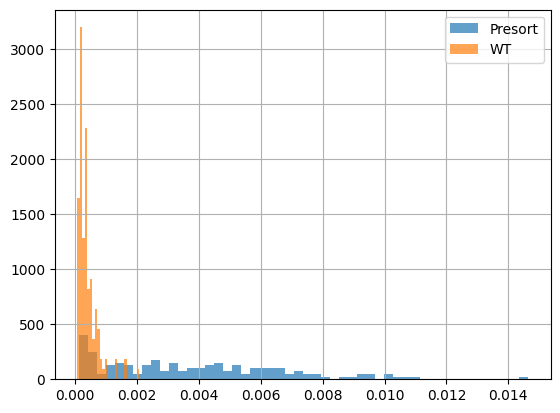

In [141]:
import matplotlib.pyplot as plt

presort_editing_avg = paired_merged_raw_encodings_editing_freqs.presort_pop_encoding_editing_per_variant_freq_avg[0]
presort_editing_avg.hist(bins=50, label="Presort", density=True, alpha=0.7)
wt_editing_avg = paired_merged_raw_encodings_editing_freqs.ctrl_pop_encoding_editing_per_variant_freq_avg[0]
wt_editing_avg = wt_editing_avg[wt_editing_avg.index.isin(presort_editing_avg.index)]
wt_editing_avg.hist(bins=25, label="WT", density=True, alpha=0.7)

plt.legend()
plt.show()

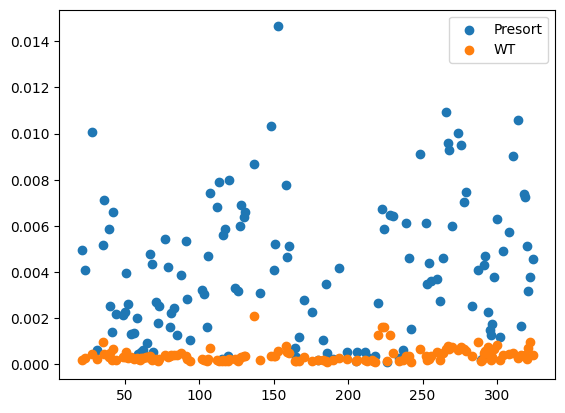

In [154]:
index_pos = [int(index[0:index.index(">")-1]) for index in presort_editing_avg.index]
plt.scatter(index_pos, presort_editing_avg, label="Presort")

index_pos = [int(index[0:index.index(">")-1]) for index in wt_editing_avg.index]
plt.scatter(index_pos, wt_editing_avg, label="WT")
plt.legend()
#plt.xlim(130, 170)
plt.show()

In [23]:
encoding_df = paired_merged_raw_encodings.baseline_pop_encodings_df_experiment_list[0][0]

In [45]:
position_series.unique()

array([ 21,  23,  28,  31,  35,  36,  39,  40,  41,  42,  44,  49,  50,
        51,  52,  54,  56,  58,  59,  60,  61,  62,  64,  65,  67,  68,
        69,  71,  72,  73,  77,  79,  80,  81,  83,  85,  88,  91,  92,
        94, 102, 103, 105, 106, 107, 112, 113, 115, 116, 117, 119, 120,
       124, 126, 127, 128, 130, 131, 137, 141, 148, 150, 151, 153, 158,
       159, 160, 164, 165, 167, 170, 176, 180, 183, 185, 186, 190, 194,
       199, 205, 206, 211, 213, 216, 217, 218, 220, 223, 224, 226, 228,
       230, 234, 237, 239, 241, 242, 248, 252, 253, 254, 256, 260, 262,
       264, 266, 267, 268, 270, 274, 276, 278, 279, 283, 287, 289, 290,
       291, 292, 294, 295, 296, 297, 298, 300, 302, 304, 308, 311, 314,
       316, 318, 319, 320, 321, 322, 324])

In [37]:
nt_columns_indicator

0       True
1       True
2       True
3       True
4       True
       ...  
133     True
134     True
135     True
136     True
137    False
Length: 138, dtype: bool

In [35]:
parse_position = lambda feature: int(feature[:feature.index(">")-1])
parse_ref = lambda feature: feature[feature.index(">")-1:feature.index(">")]
parse_alt = lambda feature: feature[feature.index(">")+1:]

feature_names = encoding_df.columns[nt_columns_indicator] + encoding_df.columns[~nt_columns_indicator]
position_series = pd.Series([parse_position(col) for col in encoding_df.columns if ">" in col])[nt_columns_indicator] + 
ref_series = pd.Series([parse_ref(col) for col in encoding_df.columns if ">" in col])[nt_columns_indicator]
alt_series = pd.Series([parse_alt(col) for col in encoding_df.columns if ">" in col])[nt_columns_indicator]


In [72]:
nt_columns_indicator = pd.Series([">" in col for col in encoding_df.columns])
position_series = pd.Series([parse_position(col) for col in encoding_df.columns[nt_columns_indicator]])
encoding_only_df = encoding_df.loc[:, encoding_df.columns[nt_columns_indicator]]
reads_df = encoding_df.loc[:, encoding_df.columns[~nt_columns_indicator]]
assert reads_df.shape[1] == 1
reads_series = reads_df.iloc[:, 0]

read_series_per_position = [reads_series[encoding_only_df.loc[:, encoding_only_df.columns[position_series == position]].sum(axis=1)>0] for position in position_series.unique()]
encoding_df_position_collapsed_freq = pd.Series([sum(read_series_subset)/sum(reads_series) for read_series_subset in read_series_per_position], index=position_series.unique())

In [92]:
nt_columns_indicator = pd.Series([">" in col for col in encoding_df.columns])
encoding_only_df = encoding_df.loc[:, encoding_df.columns[nt_columns_indicator]]
reads_df = encoding_df.loc[:, encoding_df.columns[~nt_columns_indicator]]
assert reads_df.shape[1] == 1
reads_series = reads_df.iloc[:, 0]

encoding_only_reads_mul_df = encoding_only_df.mul(reads_series, axis=0)
encoding_only_reads_mul_df.sum(axis=0) / sum(reads_series)

FullChange
21T>C     0.004750
23T>C     0.004221
28A>G     0.007898
31T>C     0.000480
35T>C     0.004981
            ...   
319A>G    0.006974
320A>G    0.005147
321A>G    0.003041
322A>G    0.004023
324A>G    0.003549
Length: 137, dtype: float64

In [110]:
paired_merged_raw_encodings_editing_freqs = cmm.EncodingEditingFrequenciesExperimentalGroup(paired_merged_raw_encodings)

ctrl_pop_encoding_editing_freq_avg_level was set to max depth of ctrl_pop_encodings_df_list, so no average was calculated
ctrl_pop_encoding_editing_freq_avg_level was set to max depth of ctrl_pop_encodings_df_list, so no average was calculated


In [104]:
paired_merged_raw_encodings_editing_freqs.baseline_pop_encoding_editing_per_variant_freq_avg

{1: [FullChange
  21T>C     0.004464
  23T>C     0.004387
  28A>G     0.008640
  31T>C     0.000519
  35T>C     0.005263
              ...   
  319A>G    0.007277
  320A>G    0.005643
  321A>G    0.003178
  322A>G    0.003765
  324A>G    0.003762
  Length: 137, dtype: float64],
 0: FullChange
 21T>C     0.004464
 23T>C     0.004387
 28A>G     0.008640
 31T>C     0.000519
 35T>C     0.005263
             ...   
 319A>G    0.007277
 320A>G    0.005643
 321A>G    0.003178
 322A>G    0.003765
 324A>G    0.003762
 Length: 137, dtype: float64}

### Run for EvoCDA

In [9]:
root_dir = "/data/pinello/PROJECTS/2023_08_CD19_manuscript/Core_Processing_Analysis/Analysis/2024_01_EC_Crispresso_Millipede_Reporting_copy/20240122_CRISPResso2Batch_Results/evoCDA_pooled/unmerged_PE_middle/CRISPRessoBatch_on_evoCDA_pooled_unmerged_PE_middle/"

encoding_parameters_denoised_removed = cme.EncodingParameters(complete_amplicon_sequence="ACATGCTCTAGTGAAAGCCAGTCTGGGCAGCTGGGTAGCTAATGAGGGGATTAGAGAGATTTTGTTGAATGAAAGGCAGATTGAGTCCTGCTACTCGCCCCCTTCATTCCCCTTCATTCATGCCTCATTCTTCCGCCTCCCAGCCGCCTCAACTGGCCAAAGGGAAGTGGAGGCCCTGCCACCTGTAGGGAGGGTCCCCTGGGGCTTGCCCACAGCAAACAGGAAGTCACAGCCTGGTGAGATGGGCCTGGGAATCAGCCACTGAGAAAGTGGGTCTCTTGGGTCCCTGAATTCTTTTTCTGAGTCCCTGCAGCAGTGAAAAAGACACAGAGGCACATAGAGAGTG",
                            population_baseline_suffix="_CD19minus",
                            population_target_suffix="_CD19plus",
                            population_presort_suffix="_presort",
                            wt_suffix="_wt",
                            trim_left=20,
                            trim_right=20,
                            guide_edit_positions=EvoCDA_final_editsites, 
                            guide_window_halfsize = 7, 
                            variant_types=[("C", "T"), ("G", "A")],
                            remove_denoised=True)

encoding_parameters_denoised_nonremoved = cme.EncodingParameters(complete_amplicon_sequence="ACATGCTCTAGTGAAAGCCAGTCTGGGCAGCTGGGTAGCTAATGAGGGGATTAGAGAGATTTTGTTGAATGAAAGGCAGATTGAGTCCTGCTACTCGCCCCCTTCATTCCCCTTCATTCATGCCTCATTCTTCCGCCTCCCAGCCGCCTCAACTGGCCAAAGGGAAGTGGAGGCCCTGCCACCTGTAGGGAGGGTCCCCTGGGGCTTGCCCACAGCAAACAGGAAGTCACAGCCTGGTGAGATGGGCCTGGGAATCAGCCACTGAGAAAGTGGGTCTCTTGGGTCCCTGAATTCTTTTTCTGAGTCCCTGCAGCAGTGAAAAAGACACAGAGGCACATAGAGAGTG",
                            population_baseline_suffix="_CD19minus",
                            population_target_suffix="_CD19plus",
                            population_presort_suffix="_presort",
                            wt_suffix="_wt",
                            trim_left=20,
                            trim_right=20,
                            guide_edit_positions=EvoCDA_final_editsites, 
                            guide_window_halfsize = 7, 
                            variant_types=[("C", "T"), ("G", "A")],
                            remove_denoised=False)



encoding_parameters_denoised_nonvariant_removed = cme.EncodingParameters(complete_amplicon_sequence="ACATGCTCTAGTGAAAGCCAGTCTGGGCAGCTGGGTAGCTAATGAGGGGATTAGAGAGATTTTGTTGAATGAAAGGCAGATTGAGTCCTGCTACTCGCCCCCTTCATTCCCCTTCATTCATGCCTCATTCTTCCGCCTCCCAGCCGCCTCAACTGGCCAAAGGGAAGTGGAGGCCCTGCCACCTGTAGGGAGGGTCCCCTGGGGCTTGCCCACAGCAAACAGGAAGTCACAGCCTGGTGAGATGGGCCTGGGAATCAGCCACTGAGAAAGTGGGTCTCTTGGGTCCCTGAATTCTTTTTCTGAGTCCCTGCAGCAGTGAAAAAGACACAGAGGCACATAGAGAGTG",
                            population_baseline_suffix="_CD19minus",
                            population_target_suffix="_CD19plus",
                            population_presort_suffix="_presort",
                            wt_suffix="_wt",
                            trim_left=20,
                            trim_right=20,
                            guide_edit_positions=EvoCDA_final_editsites, 
                            guide_window_halfsize = 7,
                            remove_denoised=True)

encoding_parameters_denoised_nonvariant_nonremoved = cme.EncodingParameters(complete_amplicon_sequence="ACATGCTCTAGTGAAAGCCAGTCTGGGCAGCTGGGTAGCTAATGAGGGGATTAGAGAGATTTTGTTGAATGAAAGGCAGATTGAGTCCTGCTACTCGCCCCCTTCATTCCCCTTCATTCATGCCTCATTCTTCCGCCTCCCAGCCGCCTCAACTGGCCAAAGGGAAGTGGAGGCCCTGCCACCTGTAGGGAGGGTCCCCTGGGGCTTGCCCACAGCAAACAGGAAGTCACAGCCTGGTGAGATGGGCCTGGGAATCAGCCACTGAGAAAGTGGGTCTCTTGGGTCCCTGAATTCTTTTTCTGAGTCCCTGCAGCAGTGAAAAAGACACAGAGGCACATAGAGAGTG",
                            population_baseline_suffix="_CD19minus",
                            population_target_suffix="_CD19plus",
                            population_presort_suffix="_presort",
                            wt_suffix="_wt",
                            trim_left=20,
                            trim_right=20,
                            guide_edit_positions=EvoCDA_final_editsites, 
                            guide_window_halfsize = 7,
                            remove_denoised=False)
                                           
                                           
    
encoding_parameters_nondenoised = cme.EncodingParameters(complete_amplicon_sequence="ACATGCTCTAGTGAAAGCCAGTCTGGGCAGCTGGGTAGCTAATGAGGGGATTAGAGAGATTTTGTTGAATGAAAGGCAGATTGAGTCCTGCTACTCGCCCCCTTCATTCCCCTTCATTCATGCCTCATTCTTCCGCCTCCCAGCCGCCTCAACTGGCCAAAGGGAAGTGGAGGCCCTGCCACCTGTAGGGAGGGTCCCCTGGGGCTTGCCCACAGCAAACAGGAAGTCACAGCCTGGTGAGATGGGCCTGGGAATCAGCCACTGAGAAAGTGGGTCTCTTGGGTCCCTGAATTCTTTTTCTGAGTCCCTGCAGCAGTGAAAAAGACACAGAGGCACATAGAGAGTG",
                            population_baseline_suffix="_CD19minus",
                            population_target_suffix="_CD19plus",
                            population_presort_suffix="_presort",
                            wt_suffix="_wt",
                            trim_left=20,
                            trim_right=20)


                                                         
                                                         
encoding_dataframes_denoised_removed = cme.EncodingDataFrames(encoding_parameters=encoding_parameters_denoised_removed,
                                                 reference_sequence=encoding_parameters_denoised_removed.complete_amplicon_sequence,
                                                 population_baseline_filepaths=[root_dir + "CRISPResso_on_sample_evoCDA_pooled_low_1/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_evoCDA_pooled_low_2/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_evoCDA_pooled_low_3/Alleles_frequency_table.zip"],
                                                 population_target_filepaths=[root_dir + "CRISPResso_on_sample_evoCDA_pooled_high_1/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_evoCDA_pooled_high_2/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_evoCDA_pooled_high_3/Alleles_frequency_table.zip"],
                                                 population_presort_filepaths=[root_dir + "CRISPResso_on_sample_evoCDA_pooled_presort_1/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_evoCDA_pooled_presort_2/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_evoCDA_pooled_presort_3/Alleles_frequency_table.zip"],
                                                 wt_filepaths=[root_dir + "CRISPResso_on_sample_mock_presort_1/Alleles_frequency_table.zip"])

encoding_dataframes_denoised_nonremoved = cme.EncodingDataFrames(encoding_parameters=encoding_parameters_denoised_nonremoved,
                                                 reference_sequence=encoding_parameters_denoised_nonremoved.complete_amplicon_sequence,
                                                 population_baseline_filepaths=[root_dir + "CRISPResso_on_sample_evoCDA_pooled_low_1/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_evoCDA_pooled_low_2/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_evoCDA_pooled_low_3/Alleles_frequency_table.zip"],
                                                 population_target_filepaths=[root_dir + "CRISPResso_on_sample_evoCDA_pooled_high_1/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_evoCDA_pooled_high_2/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_evoCDA_pooled_high_3/Alleles_frequency_table.zip"],
                                                 population_presort_filepaths=[root_dir + "CRISPResso_on_sample_evoCDA_pooled_presort_1/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_evoCDA_pooled_presort_2/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_evoCDA_pooled_presort_3/Alleles_frequency_table.zip"],
                                                 wt_filepaths=[root_dir + "CRISPResso_on_sample_mock_presort_1/Alleles_frequency_table.zip"])


encoding_dataframes_nondenoised = cme.EncodingDataFrames(encoding_parameters=encoding_parameters_nondenoised,
                                                 reference_sequence=encoding_parameters_nondenoised.complete_amplicon_sequence,
                                                 population_baseline_filepaths=[root_dir + "CRISPResso_on_sample_evoCDA_pooled_low_1/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_evoCDA_pooled_low_2/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_evoCDA_pooled_low_3/Alleles_frequency_table.zip"],
                                                 population_target_filepaths=[root_dir + "CRISPResso_on_sample_evoCDA_pooled_high_1/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_evoCDA_pooled_high_2/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_evoCDA_pooled_high_3/Alleles_frequency_table.zip"],
                                                 population_presort_filepaths=[root_dir + "CRISPResso_on_sample_evoCDA_pooled_presort_1/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_evoCDA_pooled_presort_2/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_evoCDA_pooled_presort_3/Alleles_frequency_table.zip"],
                                                 wt_filepaths=[root_dir + "CRISPResso_on_sample_mock_presort_1/Alleles_frequency_table.zip"])


encoding_dataframes_denoised_nonvariant_removed = cme.EncodingDataFrames(encoding_parameters=encoding_parameters_denoised_nonvariant_removed,
                                                 reference_sequence=encoding_parameters_denoised_nonvariant_removed.complete_amplicon_sequence,
                                                 population_baseline_filepaths=[root_dir + "CRISPResso_on_sample_evoCDA_pooled_low_1/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_evoCDA_pooled_low_2/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_evoCDA_pooled_low_3/Alleles_frequency_table.zip"],
                                                 population_target_filepaths=[root_dir + "CRISPResso_on_sample_evoCDA_pooled_high_1/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_evoCDA_pooled_high_2/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_evoCDA_pooled_high_3/Alleles_frequency_table.zip"],
                                                 population_presort_filepaths=[root_dir + "CRISPResso_on_sample_evoCDA_pooled_presort_1/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_evoCDA_pooled_presort_2/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_evoCDA_pooled_presort_3/Alleles_frequency_table.zip"],
                                                 wt_filepaths=[root_dir + "CRISPResso_on_sample_mock_presort_1/Alleles_frequency_table.zip"])

encoding_dataframes_denoised_nonvariant_nonremoved = cme.EncodingDataFrames(encoding_parameters=encoding_parameters_denoised_nonvariant_nonremoved,
                                                 reference_sequence=encoding_parameters_denoised_nonvariant_nonremoved.complete_amplicon_sequence,
                                                 population_baseline_filepaths=[root_dir + "CRISPResso_on_sample_evoCDA_pooled_low_1/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_evoCDA_pooled_low_2/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_evoCDA_pooled_low_3/Alleles_frequency_table.zip"],
                                                 population_target_filepaths=[root_dir + "CRISPResso_on_sample_evoCDA_pooled_high_1/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_evoCDA_pooled_high_2/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_evoCDA_pooled_high_3/Alleles_frequency_table.zip"],
                                                 population_presort_filepaths=[root_dir + "CRISPResso_on_sample_evoCDA_pooled_presort_1/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_evoCDA_pooled_presort_2/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_evoCDA_pooled_presort_3/Alleles_frequency_table.zip"],
                                                 wt_filepaths=[root_dir + "CRISPResso_on_sample_mock_presort_1/Alleles_frequency_table.zip"])

In [168]:
encoding_parameters_denoised_nonposition_nontrimmed_removed = cme.EncodingParameters(complete_amplicon_sequence="ACATGCTCTAGTGAAAGCCAGTCTGGGCAGCTGGGTAGCTAATGAGGGGATTAGAGAGATTTTGTTGAATGAAAGGCAGATTGAGTCCTGCTACTCGCCCCCTTCATTCCCCTTCATTCATGCCTCATTCTTCCGCCTCCCAGCCGCCTCAACTGGCCAAAGGGAAGTGGAGGCCCTGCCACCTGTAGGGAGGGTCCCCTGGGGCTTGCCCACAGCAAACAGGAAGTCACAGCCTGGTGAGATGGGCCTGGGAATCAGCCACTGAGAAAGTGGGTCTCTTGGGTCCCTGAATTCTTTTTCTGAGTCCCTGCAGCAGTGAAAAAGACACAGAGGCACATAGAGAGTG",
                            population_baseline_suffix="_CD19minus",
                            population_target_suffix="_CD19plus",
                            population_presort_suffix="_presort",
                            wt_suffix="_wt",
                            variant_types=[("C", "T"), ("G", "A")],
                            remove_denoised=True)

In [171]:
root_dir = "/data/pinello/PROJECTS/2023_08_CD19_manuscript/Core_Processing_Analysis/Analysis/2024_01_EC_Crispresso_Millipede_Reporting_copy/20240122_CRISPResso2Batch_Results/evoCDA_pooled/unmerged_PE_middle/CRISPRessoBatch_on_evoCDA_pooled_unmerged_PE_middle/"
encoding_dataframes_denoised_nonposition_nontrimmed_removed = cme.EncodingDataFrames(encoding_parameters=encoding_parameters_denoised_nonposition_nontrimmed_removed,
                                                 reference_sequence=encoding_parameters_denoised_nonposition_nontrimmed_removed.complete_amplicon_sequence,
                                                 population_baseline_filepaths=[root_dir + "CRISPResso_on_sample_evoCDA_pooled_low_1/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_evoCDA_pooled_low_2/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_evoCDA_pooled_low_3/Alleles_frequency_table.zip"],
                                                 population_target_filepaths=[root_dir + "CRISPResso_on_sample_evoCDA_pooled_high_1/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_evoCDA_pooled_high_2/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_evoCDA_pooled_high_3/Alleles_frequency_table.zip"],
                                                 population_presort_filepaths=[root_dir + "CRISPResso_on_sample_evoCDA_pooled_presort_1/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_evoCDA_pooled_presort_2/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_evoCDA_pooled_presort_3/Alleles_frequency_table.zip"],
                                                 wt_filepaths=[root_dir + "CRISPResso_on_sample_mock_presort_1/Alleles_frequency_table.zip"])

In [172]:
%%time
# Takes around 48min for 50cores
print("Reading tables")
encoding_dataframes_denoised_nonposition_nontrimmed_removed.read_crispresso_allele_tables()
print("Encoding tables")
encoding_dataframes_denoised_nonposition_nontrimmed_removed.encode_crispresso_allele_table(progress_bar=True, cores=100)
print("Postprocessing tables")
encoding_dataframes_denoised_nonposition_nontrimmed_removed.postprocess_encoding()

Reading tables
Encoding tables
INFO: Pandarallel will run on 100 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
Encoding population_baseline_df


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Encoding population_target_df


Encoding population_presort_df


Encoding population_wt_df


Postprocessing tables
Processing encoding columns
Adding read column
Performing denoising
Denoising with positions [] and variant types [('C', 'T'), ('G', 'A')]
Filtering by variant types
1542 variant types
['0A>C', '0A>T', '0A>G', '0A>N', '0A>-', '1C>A', '1C>G', '1C>N', '1C>-', '2A>C', '2A>T', '2A>G', '2A>N', '2A>-', '3T>A', '3T>C', '3T>G', '3T>N', '3T>-', '4G>C', '4G>T', '4G>N', '4G>-', '5C>A', '5C>G', '5C>N', '5C>-', '6T>A', '6T>C', '6T>G', '6T>N', '6T>-', '7C>A', '7C>G', '7C>N', '7C>-', '8T>A', '8T>C', '8T>G', '8T>N', '8T>-', '9A>C', '9A>T', '9A>G', '9A>N', '9A>-', '10G>C', '10G>T', '10G>N', '10G>-', '11T>A', '11T>C', '11T>G', '11T>N', '11T>-', '12G>C', '12G>T', '12G>N', '12G>-', '13A>C', '13A>T', '13A>G', '13A>N', '13A>-', '14A>C', '14A>T', '14A>G', '14A>N', '14A>-', '15A>C', '15A>T', '15A>G', '15A>N', '15A>-', '16G>C', '16G>T', '16G>N', '16G>-', '17C>A', '17C>G', '17C>N', '17C>-', '18C>A', '18C>G', '18C>N', '18C>-', '19A>C', '19A>T', '19A>G', '19A>N', '19A>-', '20G>C', '20G>T', '

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.groupby(feature_colnames, as_index=True).sum().reset_index())
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.

CPU times: user 1min 4s, sys: 10min 2s, total: 11min 6s
Wall time: 16min 32s


In [ ]:
import pickle

rerun = True
if rerun:
    with open('20240901_v0_1_89_EvoCDA_encoding_dataframes_denoised_nonposition_nontrimmed_removed.pkl', 'wb') as fn: 
        pickle.dump(encoding_dataframes_denoised_nonposition_nontrimmed_removed, fn) 
else:
    with open('20240901_v0_1_89_EvoCDA_encoding_dataframes_denoised_nonposition_nontrimmed_removed.pkl', 'rb') as fn: 
        encoding_dataframes_denoised_nonposition_nontrimmed_removed = pickle.load(fn) 

In [ ]:
cme.save_encodings(encoding_dataframes_denoised_nonposition_nontrimmed_removed.encodings_collapsed_merged, sort_column="#Reads_presort", filename="./20240901_v0_1_89_EvoCDA_encoding_dataframes_denoised_nonposition_nontrimmed_removed_ABE8e_encodings_rep{}.tsv")
cme.save_encodings(encoding_dataframes_denoised_nonposition_nontrimmed_removed.population_wt_encoding_processed, sort_column="#Reads_wt", filename="./20240901_v0_1_89_EvoCDA_encoding_dataframes_denoised_nonposition_nontrimmed_removed_wt_encodings_rep{}.tsv")
cme.save_encodings_df(encoding_dataframes_denoised_nonposition_nontrimmed_removed.population_baseline_encoding_processed, filename="./20240901_v0_1_89_EvoCDA_encoding_dataframes_denoised_nonposition_nontrimmed_removed_CD19minus_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_nonposition_nontrimmed_removed.population_target_encoding_processed, filename="./20240901_v0_1_89_EvoCDA_encoding_dataframes_denoised_nonposition_nontrimmed_removed_CD19plus_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_nonposition_nontrimmed_removed.population_presort_encoding_processed, filename="./20240901_v0_1_89_EvoCDA_encoding_dataframes_denoised_nonposition_nontrimmed_removed_presort_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_nonposition_nontrimmed_removed.population_wt_encoding_processed, filename="./20240901_v0_1_89_EvoCDA_encoding_dataframes_denoised_nonposition_nontrimmed_removed_wt_encodings_rep{}.pkl")

In [10]:
%%time
# Takes around 48min for 50cores
print("Reading tables")
encoding_dataframes_denoised_removed.read_crispresso_allele_tables()
print("Encoding tables")
encoding_dataframes_denoised_removed.encode_crispresso_allele_table(progress_bar=True, cores=60)
print("Postprocessing tables")
encoding_dataframes_denoised_removed.postprocess_encoding()

Reading tables
Encoding tables
INFO: Pandarallel will run on 60 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
Encoding population_baseline_df


Encoding population_target_df


Encoding population_presort_df


Encoding population_wt_df


Postprocessing tables
Trimming encodings with trim_left=20 and trim_right=20
Processing encoding columns
Adding read column
Performing denoising
Denoising with positions [10, 31, 114, 117, 126, 139, 156, 172, 187, 195, 198, 213, 225, 229, 235, 249, 265] and variant types [('C', 'T'), ('G', 'A')]
Filtering by editable positions
645 non-editable positions
['20G>A', '20G>C', '20G>T', '20G>N', '20G>-', '21T>A', '21T>C', '21T>G', '21T>N', '21T>-', '22C>A', '22C>T', '22C>G', '22C>N', '22C>-', '23T>A', '23T>C', '23T>G', '23T>N', '23T>-', '39T>A', '39T>C', '39T>G', '39T>N', '39T>-', '40A>C', '40A>T', '40A>G', '40A>N', '40A>-', '41A>C', '41A>T', '41A>G', '41A>N', '41A>-', '42T>A', '42T>C', '42T>G', '42T>N', '42T>-', '43G>A', '43G>C', '43G>T', '43G>N', '43G>-', '44A>C', '44A>T', '44A>G', '44A>N', '44A>-', '45G>A', '45G>C', '45G>T', '45G>N', '45G>-', '46G>A', '46G>C', '46G>T', '46G>N', '46G>-', '47G>A', '47G>C', '47G>T', '47G>N', '47G>-', '48G>A', '48G>C', '48G>T', '48G>N', '48G>-', '49A>C', '49A

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.groupby(feature_colnames, as_index=True).sum().reset_index())
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.

CPU times: user 46.5 s, sys: 4min 35s, total: 5min 22s
Wall time: 8min 19s


In [11]:
%%time
# Takes around 48min for 50cores
print("Reading tables")
encoding_dataframes_denoised_nonremoved.read_crispresso_allele_tables()
print("Encoding tables")
encoding_dataframes_denoised_nonremoved.encode_crispresso_allele_table(progress_bar=True, cores=60)
print("Postprocessing tables")
encoding_dataframes_denoised_nonremoved.postprocess_encoding()

Reading tables
Encoding tables
INFO: Pandarallel will run on 60 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
Encoding population_baseline_df


Encoding population_target_df


Encoding population_presort_df


Encoding population_wt_df


Postprocessing tables
Trimming encodings with trim_left=20 and trim_right=20
Processing encoding columns
Adding read column
Performing denoising
Denoising with positions [10, 31, 114, 117, 126, 139, 156, 172, 187, 195, 198, 213, 225, 229, 235, 249, 265] and variant types [('C', 'T'), ('G', 'A')]
Filtering by editable positions
645 non-editable positions
['20G>A', '20G>C', '20G>T', '20G>N', '20G>-', '21T>A', '21T>C', '21T>G', '21T>N', '21T>-', '22C>A', '22C>T', '22C>G', '22C>N', '22C>-', '23T>A', '23T>C', '23T>G', '23T>N', '23T>-', '39T>A', '39T>C', '39T>G', '39T>N', '39T>-', '40A>C', '40A>T', '40A>G', '40A>N', '40A>-', '41A>C', '41A>T', '41A>G', '41A>N', '41A>-', '42T>A', '42T>C', '42T>G', '42T>N', '42T>-', '43G>A', '43G>C', '43G>T', '43G>N', '43G>-', '44A>C', '44A>T', '44A>G', '44A>N', '44A>-', '45G>A', '45G>C', '45G>T', '45G>N', '45G>-', '46G>A', '46G>C', '46G>T', '46G>N', '46G>-', '47G>A', '47G>C', '47G>T', '47G>N', '47G>-', '48G>A', '48G>C', '48G>T', '48G>N', '48G>-', '49A>C', '49A

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.groupby(feature_colnames, as_index=True).sum().reset_index())
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.

CPU times: user 1min 2s, sys: 4min 32s, total: 5min 35s
Wall time: 8min 1s


In [12]:
%%time
# Takes around 48min for 50cores
print("Reading tables")
encoding_dataframes_denoised_nonvariant_removed.read_crispresso_allele_tables()
print("Encoding tables")
encoding_dataframes_denoised_nonvariant_removed.encode_crispresso_allele_table(progress_bar=True, cores=60)
print("Postprocessing tables")
encoding_dataframes_denoised_nonvariant_removed.postprocess_encoding()

Reading tables
Encoding tables
INFO: Pandarallel will run on 60 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
Encoding population_baseline_df


Encoding population_target_df


Encoding population_presort_df


Encoding population_wt_df


Postprocessing tables
Trimming encodings with trim_left=20 and trim_right=20
Processing encoding columns
Adding read column
Performing denoising
Denoising with positions [10, 31, 114, 117, 126, 139, 156, 172, 187, 195, 198, 213, 225, 229, 235, 249, 265] and variant types []
Filtering by editable positions
645 non-editable positions
['20G>A', '20G>C', '20G>T', '20G>N', '20G>-', '21T>A', '21T>C', '21T>G', '21T>N', '21T>-', '22C>A', '22C>T', '22C>G', '22C>N', '22C>-', '23T>A', '23T>C', '23T>G', '23T>N', '23T>-', '39T>A', '39T>C', '39T>G', '39T>N', '39T>-', '40A>C', '40A>T', '40A>G', '40A>N', '40A>-', '41A>C', '41A>T', '41A>G', '41A>N', '41A>-', '42T>A', '42T>C', '42T>G', '42T>N', '42T>-', '43G>A', '43G>C', '43G>T', '43G>N', '43G>-', '44A>C', '44A>T', '44A>G', '44A>N', '44A>-', '45G>A', '45G>C', '45G>T', '45G>N', '45G>-', '46G>A', '46G>C', '46G>T', '46G>N', '46G>-', '47G>A', '47G>C', '47G>T', '47G>N', '47G>-', '48G>A', '48G>C', '48G>T', '48G>N', '48G>-', '49A>C', '49A>T', '49A>G', '49A>N',

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.groupby(feature_colnames, as_index=True).sum().reset_index())
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.

CPU times: user 53.6 s, sys: 5min 11s, total: 6min 4s
Wall time: 8min 36s


In [13]:
%%time
# Takes around 48min for 50cores
print("Reading tables")
encoding_dataframes_denoised_nonvariant_nonremoved.read_crispresso_allele_tables()
print("Encoding tables")
encoding_dataframes_denoised_nonvariant_nonremoved.encode_crispresso_allele_table(progress_bar=True, cores=60)
print("Postprocessing tables")
encoding_dataframes_denoised_nonvariant_nonremoved.postprocess_encoding()

Reading tables
Encoding tables
INFO: Pandarallel will run on 60 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
Encoding population_baseline_df


Encoding population_target_df


Encoding population_presort_df


Encoding population_wt_df


Postprocessing tables
Trimming encodings with trim_left=20 and trim_right=20
Processing encoding columns
Adding read column
Performing denoising
Denoising with positions [10, 31, 114, 117, 126, 139, 156, 172, 187, 195, 198, 213, 225, 229, 235, 249, 265] and variant types []
Filtering by editable positions
645 non-editable positions
['20G>A', '20G>C', '20G>T', '20G>N', '20G>-', '21T>A', '21T>C', '21T>G', '21T>N', '21T>-', '22C>A', '22C>T', '22C>G', '22C>N', '22C>-', '23T>A', '23T>C', '23T>G', '23T>N', '23T>-', '39T>A', '39T>C', '39T>G', '39T>N', '39T>-', '40A>C', '40A>T', '40A>G', '40A>N', '40A>-', '41A>C', '41A>T', '41A>G', '41A>N', '41A>-', '42T>A', '42T>C', '42T>G', '42T>N', '42T>-', '43G>A', '43G>C', '43G>T', '43G>N', '43G>-', '44A>C', '44A>T', '44A>G', '44A>N', '44A>-', '45G>A', '45G>C', '45G>T', '45G>N', '45G>-', '46G>A', '46G>C', '46G>T', '46G>N', '46G>-', '47G>A', '47G>C', '47G>T', '47G>N', '47G>-', '48G>A', '48G>C', '48G>T', '48G>N', '48G>-', '49A>C', '49A>T', '49A>G', '49A>N',

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.groupby(feature_colnames, as_index=True).sum().reset_index())
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.

CPU times: user 1min 7s, sys: 5min 47s, total: 6min 54s
Wall time: 10min


In [14]:
%%time
# Takes around 48min for 50cores
print("Reading tables")
encoding_dataframes_nondenoised.read_crispresso_allele_tables()
print("Encoding tables")
encoding_dataframes_nondenoised.encode_crispresso_allele_table(progress_bar=True, cores=60)
print("Postprocessing tables")
encoding_dataframes_nondenoised.postprocess_encoding()

Reading tables
Encoding tables
INFO: Pandarallel will run on 60 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
Encoding population_baseline_df


Encoding population_target_df


Encoding population_presort_df


Encoding population_wt_df


Postprocessing tables
Trimming encodings with trim_left=20 and trim_right=20
Processing encoding columns
Adding read column
Performing denoising
Not denoising sample
Not denoising sample
Not denoising sample
Not denoising sample
Collapsing encoding


/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.groupby(feature_colnames, as_index=True).sum().reset_index())
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.

CPU times: user 1min 10s, sys: 5min 56s, total: 7min 6s
Wall time: 10min 5s


In [15]:
import pickle

rerun = True
if rerun:
    with open('20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_removed.pkl', 'wb') as fn: 
        pickle.dump(encoding_dataframes_denoised_removed, fn) 
else:
    with open('20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_removed.pkl', 'rb') as fn: 
        encoding_dataframes_denoised_removed = pickle.load(fn) 

In [16]:
import pickle

rerun = True
if rerun:
    with open('20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_nonremoved.pkl', 'wb') as fn: 
        pickle.dump(encoding_dataframes_denoised_nonremoved, fn) 
else:
    with open('20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_nonremoved.pkl', 'rb') as fn: 
        encoding_dataframes_denoised_nonremoved = pickle.load(fn) 

In [17]:
import pickle

rerun = True
if rerun:
    with open('20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_nonvariant_removed.pkl', 'wb') as fn: 
        pickle.dump(encoding_dataframes_denoised_nonvariant_removed, fn) 
else:
    with open('20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_nonvariant_removed.pkl', 'rb') as fn: 
        encoding_dataframes_denoised_nonvariant_removed = pickle.load(fn) 

In [18]:
import pickle

rerun = True
if rerun:
    with open('20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_nonvariant_nonremoved.pkl', 'wb') as fn: 
        pickle.dump(encoding_dataframes_denoised_nonvariant_nonremoved, fn) 
else:
    with open('20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_nonvariant_nonremoved.pkl', 'rb') as fn: 
        encoding_dataframes_denoised_nonvariant_nonremoved = pickle.load(fn) 

In [ ]:
import pickle

rerun = True
if rerun:
    with open('20240816_v0_1_84_EvoCDA_encoding_dataframes_nondenoised.pkl', 'wb') as fn: 
        pickle.dump(encoding_dataframes_nondenoised, fn) 
else:
    with open('20240816_v0_1_84_EvoCDA_encoding_dataframes_nondenoised.pkl', 'rb') as fn: 
        encoding_dataframes_nondenoised = pickle.load(fn) 

In [ ]:
cme.save_encodings(encoding_dataframes_denoised_removed.encodings_collapsed_merged, sort_column="#Reads_presort", filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_removed_ABE8e_encodings_rep{}.tsv")
cme.save_encodings(encoding_dataframes_denoised_removed.population_wt_encoding_processed, sort_column="#Reads_wt", filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_removed_wt_encodings_rep{}.tsv")
cme.save_encodings_df(encoding_dataframes_denoised_removed.population_baseline_encoding_processed, filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_removed_CD19minus_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_removed.population_target_encoding_processed, filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_removed_CD19plus_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_removed.population_presort_encoding_processed, filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_removed_presort_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_removed.population_wt_encoding_processed, filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_removed_wt_encodings_rep{}.pkl")

In [ ]:
cme.save_encodings(encoding_dataframes_denoised_nonremoved.encodings_collapsed_merged, sort_column="#Reads_presort", filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_nonremoved_ABE8e_encodings_rep{}.tsv")
cme.save_encodings(encoding_dataframes_denoised_nonremoved.population_wt_encoding_processed, sort_column="#Reads_wt", filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_nonremoved_wt_encodings_rep{}.tsv")
cme.save_encodings_df(encoding_dataframes_denoised_nonremoved.population_baseline_encoding_processed, filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_nonremoved_CD19minus_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_nonremoved.population_target_encoding_processed, filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_nonremoved_CD19plus_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_nonremoved.population_presort_encoding_processed, filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_nonremoved_presort_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_nonremoved.population_wt_encoding_processed, filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_nonremoved_wt_encodings_rep{}.pkl")

In [ ]:
cme.save_encodings(encoding_dataframes_denoised_nonvariant_removed.encodings_collapsed_merged, sort_column="#Reads_presort", filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_removed_nonvariant_ABE8e_encodings_rep{}.tsv")
cme.save_encodings(encoding_dataframes_denoised_nonvariant_removed.population_wt_encoding_processed, sort_column="#Reads_wt", filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_removed_nonvariant_wt_encodings_rep{}.tsv")
cme.save_encodings_df(encoding_dataframes_denoised_nonvariant_removed.population_baseline_encoding_processed, filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_removed_nonvariant_CD19minus_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_nonvariant_removed.population_target_encoding_processed, filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_removed_nonvariant_CD19plus_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_nonvariant_removed.population_presort_encoding_processed, filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_removed_nonvariant_presort_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_nonvariant_removed.population_wt_encoding_processed, filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_removed_nonvariant_wt_encodings_rep{}.pkl")

In [ ]:
cme.save_encodings(encoding_dataframes_denoised_nonvariant_nonremoved.encodings_collapsed_merged, sort_column="#Reads_presort", filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_nonremoved_nonvariant_ABE8e_encodings_rep{}.tsv")
cme.save_encodings(encoding_dataframes_denoised_nonvariant_nonremoved.population_wt_encoding_processed, sort_column="#Reads_wt", filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_nonremoved_nonvariant_wt_encodings_rep{}.tsv")
cme.save_encodings_df(encoding_dataframes_denoised_nonvariant_nonremoved.population_baseline_encoding_processed, filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_nonremoved_nonvariant_CD19minus_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_nonvariant_nonremoved.population_target_encoding_processed, filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_nonremoved_nonvariant_CD19plus_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_nonvariant_nonremoved.population_presort_encoding_processed, filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_nonremoved_nonvariant_presort_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_denoised_nonvariant_nonremoved.population_wt_encoding_processed, filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_denoised_nonremoved_nonvariant_wt_encodings_rep{}.pkl")

In [ ]:
cme.save_encodings(encoding_dataframes_nondenoised.encodings_collapsed_merged, sort_column="#Reads_presort", filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_nondenoised_ABE8e_encodings_rep{}.tsv")
cme.save_encodings(encoding_dataframes_nondenoised.population_wt_encoding_processed, sort_column="#Reads_wt", filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_nondenoised_wt_encodings_rep{}.tsv")
cme.save_encodings_df(encoding_dataframes_nondenoised.population_baseline_encoding_processed, filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_nondenoised_CD19minus_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_nondenoised.population_target_encoding_processed, filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_nondenoised_CD19plus_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_nondenoised.population_presort_encoding_processed, filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_nondenoised_presort_ABE8e_encodings_rep{}.pkl")
cme.save_encodings_df(encoding_dataframes_nondenoised.population_wt_encoding_processed, filename="./20240816_v0_1_84_EvoCDA_encoding_dataframes_nondenoised_wt_encodings_rep{}.pkl")